In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"]="1"

In [2]:
import numpy as np
import torch
import scanpy as sc
import muon as mu
import anndata
import mudata
import pandas as pd

print(anndata.__version__)
print(mudata.__version__)
print(sc.__version__)
print(torch.__version__)

0.8.0
0.2.1
1.9.2
1.11.0


In [3]:
%load_ext autoreload
%autoreload 2

In [4]:
from src.mvae.model import MVAE
from src.mvae.train import train_mvae
from src.mvae.dataloader import setup_mudata
from src.mvae.diagnostics import plot_embedding, classification_performance
from src.types import TrainParams
from src.model import ModelParams

In [5]:
mdata = mu.read('/media/yob/nacho_stuff/prostate_cancer/Integration/MVAE-PoE/OtF-prostate/data/mdata_preprocessed_final_filtered.h5mu')

In [6]:
metadata = mu.read('/media/yob/nacho_stuff/prostate_cancer/Integration/MVAE-PoE/OtF-prostate/data/mdata_metadata.h5mu')
mdata.obs["new_ann"] = metadata.obs["new_ann"]
mdata.mod["msi"].obs["new_ann"] = metadata.obs["new_ann"]
mdata.mod["rna"].obs["new_ann"] = metadata.obs["new_ann"]

In [7]:
setup_mudata(mdata, batch_key="sample")

16

In [17]:
mdata

MuData object with n_obs × n_vars = 42475 × 31460
  obs:	'sample', 'tissue', 'patient', 'ann', 'imagerow', 'imagecol', 'new_ann', 'batch_id', 'r0.8'
  obsm:	'z1_s', 'z2_s', 'z1_p', 'z2_p', 'z1_mod', 'z2_mod', 'z1_batch_free', 'z2_batch_free', 'X_umap', 'X_z1_s', 'X_z2_s', 'X_z1_p', 'X_z2_p', 'X_z1_mod', 'X_z2_mod', 'X_z1_batch_free', 'X_z2_batch_free', 'z', 'X_mvae'
  obsp:	'neigh_z1_s_distances', 'neigh_z1_s_connectivities', 'neigh_z2_s_distances', 'neigh_z2_s_connectivities', 'neigh_z1_p_distances', 'neigh_z1_p_connectivities', 'neigh_z2_p_distances', 'neigh_z2_p_connectivities', 'neigh_z1_mod_distances', 'neigh_z1_mod_connectivities', 'neigh_z2_mod_distances', 'neigh_z2_mod_connectivities', 'neigh_z1_batch_free_distances', 'neigh_z1_batch_free_connectivities', 'neigh_z2_batch_free_distances', 'neigh_z2_batch_free_connectivities', 'distances', 'connectivities'
  2 modalities
    rna:	42475 x 18950
      obs:	'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'n_counts', 'n_genes', 'size_factors', 'sample', 'type', 'patient', 'ann', 'tissue', 'imagerow', 'imagecol', 'new_ann', 'batch_id'
      obsm:	'spatial'
      layers:	'counts', 'scran_normalization', 'spotclean'
    msi:	42475 x 12510
      obs:	'ST_barcode', 'sample', 'tissue', 'patient', 'ann', 'imagerow', 'imagecol', 'new_ann', 'batch_id'
      obsm:	'spatial'

## No LISI

In [16]:
train_params = TrainParams(add_lisi_loss=False, test_patience=20, train_size=0.8, n_epochs=100, learning_rate=1e-4, batch_size=128, params_file="mvae_beta0.01_betap0.001_betamod0.1_epoch100")
model_params = ModelParams(beta=0.01, n_layers=2, z_dim=100, n_hidden=300, use_cuda=True)
torch.set_num_threads(16)
model = MVAE(mdata, model_params)

In [17]:
train_mvae(model, mdata, train_params,"sample")

Train data size: 33980
Test data size: 8495


100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.96it/s]

EarlyStopping (epoch: 1): train loss improved to 0.05444764124778806



100%|███████████████████████████████████████████| 67/67 [00:19<00:00,  3.49it/s]

EarlyStopping (epoch: 1): valid loss improved to 3.176658537850451



100%|█████████████████████████████████████████| 266/266 [01:05<00:00,  4.07it/s]

EarlyStopping (epoch: 2): train loss improved to 0.021876611619784315



100%|███████████████████████████████████████████| 67/67 [00:18<00:00,  3.60it/s]

EarlyStopping (epoch: 2): valid loss improved to 2.5020436493318474



100%|███████████████████████████████████████████| 67/67 [00:18<00:00,  3.59it/s]

EarlyStopping (epoch: 3): valid loss improved to 2.207050515644586



100%|███████████████████████████████████████████| 67/67 [00:18<00:00,  3.64it/s]

EarlyStopping (epoch: 4): valid loss improved to 2.0617984906950992



100%|███████████████████████████████████████████| 67/67 [00:18<00:00,  3.62it/s]

EarlyStopping (epoch: 5): valid loss improved to 1.9735500207587855



100%|███████████████████████████████████████████| 67/67 [00:18<00:00,  3.66it/s]

EarlyStopping (epoch: 6): valid loss improved to 1.9117732243751413



 92%|█████████████████████████████████████▉   | 246/266 [01:03<00:05,  3.90it/s]


KeyboardInterrupt: 

### beta=0.001

In [8]:
train_params = TrainParams(add_lisi_loss=False, test_patience=100, train_size=0.8, n_epochs=100, learning_rate=1e-4, batch_size=128, params_file="mvae_beta0.001_gamma0")
model_params = ModelParams(beta=0.001, n_layers=2, z_dim=100, n_hidden=300, use_cuda=True)
torch.set_num_threads(16)
model = MVAE(mdata, model_params)

In [9]:
train_mvae(model, mdata, train_params,"sample")

Train data size: 33980
Test data size: 8495


100%|█████████████████████████████████████████| 266/266 [01:14<00:00,  3.55it/s]

EarlyStopping (epoch: 1): train loss improved to 0.05465945344310848



100%|███████████████████████████████████████████| 67/67 [00:18<00:00,  3.69it/s]

EarlyStopping (epoch: 1): valid loss improved to 3.2230688244549195



100%|█████████████████████████████████████████| 266/266 [01:08<00:00,  3.87it/s]

EarlyStopping (epoch: 2): train loss improved to 0.021744123909878968



100%|███████████████████████████████████████████| 67/67 [00:17<00:00,  3.82it/s]

EarlyStopping (epoch: 2): valid loss improved to 2.490954313705217



100%|███████████████████████████████████████████| 67/67 [00:17<00:00,  3.91it/s]

EarlyStopping (epoch: 3): valid loss improved to 2.2148303167143863



100%|███████████████████████████████████████████| 67/67 [00:16<00:00,  4.07it/s]

EarlyStopping (epoch: 4): valid loss improved to 2.052898257525999



100%|███████████████████████████████████████████| 67/67 [00:16<00:00,  3.95it/s]

EarlyStopping (epoch: 5): valid loss improved to 1.961779443185721



100%|███████████████████████████████████████████| 67/67 [00:17<00:00,  3.80it/s]

EarlyStopping (epoch: 6): valid loss improved to 1.902944287257408



100%|███████████████████████████████████████████| 67/67 [00:16<00:00,  4.05it/s]

EarlyStopping (epoch: 7): valid loss improved to 1.857303973454148



100%|███████████████████████████████████████████| 67/67 [00:18<00:00,  3.68it/s]

EarlyStopping (epoch: 8): valid loss improved to 1.8297521427496155



100%|███████████████████████████████████████████| 67/67 [00:17<00:00,  3.79it/s]

EarlyStopping (epoch: 9): valid loss improved to 1.8043469172805102



100%|███████████████████████████████████████████| 67/67 [00:17<00:00,  3.80it/s]

EarlyStopping (epoch: 10): valid loss improved to 1.7849376201629639



100%|███████████████████████████████████████████| 67/67 [00:17<00:00,  3.85it/s]

EarlyStopping (epoch: 11): valid loss improved to 1.7723474769449945



100%|█████████████████████████████████████████| 266/266 [01:08<00:00,  3.88it/s]

EarlyStopping (epoch: 12): train loss hasn't improved: 0.014330699708336869. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:17<00:00,  3.80it/s]

EarlyStopping (epoch: 12): valid loss improved to 1.7565096509990408



100%|█████████████████████████████████████████| 266/266 [01:04<00:00,  4.11it/s]

EarlyStopping (epoch: 13): train loss hasn't improved: 0.01423118121137052. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.95it/s]

EarlyStopping (epoch: 14): train loss hasn't improved: 0.014149213816012404. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:17<00:00,  3.83it/s]

EarlyStopping (epoch: 14): valid loss improved to 1.7430198085841848



100%|█████████████████████████████████████████| 266/266 [01:13<00:00,  3.63it/s]

EarlyStopping (epoch: 15): train loss hasn't improved: 0.014103272025763391. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:09<00:00,  3.85it/s]

EarlyStopping (epoch: 16): train loss hasn't improved: 0.014044147589544888. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:18<00:00,  3.66it/s]

EarlyStopping (epoch: 16): valid loss improved to 1.7244611782814139



100%|█████████████████████████████████████████| 266/266 [01:09<00:00,  3.80it/s]

EarlyStopping (epoch: 17): train loss hasn't improved: 0.01399041909270598. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:05<00:00,  4.07it/s]

EarlyStopping (epoch: 18): train loss hasn't improved: 0.013947009728051692. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:11<00:00,  3.72it/s]

EarlyStopping (epoch: 19): train loss hasn't improved: 0.013895681414483505. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:08<00:00,  3.87it/s]

EarlyStopping (epoch: 20): train loss hasn't improved: 0.013884480393164434. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:17<00:00,  3.79it/s]

EarlyStopping (epoch: 20): valid loss improved to 1.7120977889246016



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.91it/s]

EarlyStopping (epoch: 21): train loss hasn't improved: 0.013847373102327316. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:06<00:00,  3.99it/s]

EarlyStopping (epoch: 22): train loss hasn't improved: 0.013829928804945426. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.94it/s]

EarlyStopping (epoch: 23): train loss hasn't improved: 0.013799072139890423. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:04<00:00,  4.12it/s]

EarlyStopping (epoch: 24): train loss hasn't improved: 0.013784238497883941. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:16<00:00,  4.08it/s]

EarlyStopping (epoch: 24): valid loss improved to 1.6994823608825456



100%|█████████████████████████████████████████| 266/266 [01:03<00:00,  4.18it/s]

EarlyStopping (epoch: 25): train loss hasn't improved: 0.01376822970417263. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:08<00:00,  3.89it/s]

EarlyStopping (epoch: 26): train loss hasn't improved: 0.013740238436816229. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.92it/s]

EarlyStopping (epoch: 27): train loss hasn't improved: 0.013725667998957733. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:02<00:00,  4.23it/s]

EarlyStopping (epoch: 28): train loss hasn't improved: 0.013723572546626064. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:05<00:00,  4.06it/s]

EarlyStopping (epoch: 29): train loss hasn't improved: 0.013706697040336703. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.91it/s]

EarlyStopping (epoch: 30): train loss hasn't improved: 0.013691143395972294. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.95it/s]

EarlyStopping (epoch: 31): train loss hasn't improved: 0.01367882330534106. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.96it/s]

EarlyStopping (epoch: 32): train loss hasn't improved: 0.013671829828169151. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:16<00:00,  3.98it/s]

EarlyStopping (epoch: 32): valid loss improved to 1.6849140427005824



100%|█████████████████████████████████████████| 266/266 [01:06<00:00,  4.00it/s]

EarlyStopping (epoch: 33): train loss hasn't improved: 0.01366784317904602. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:05<00:00,  4.06it/s]

EarlyStopping (epoch: 34): train loss hasn't improved: 0.013660001498660737. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:05<00:00,  4.06it/s]

EarlyStopping (epoch: 35): train loss hasn't improved: 0.013645336237144583. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:04<00:00,  4.15it/s]

EarlyStopping (epoch: 36): train loss hasn't improved: 0.013647259485026961. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:08<00:00,  3.87it/s]

EarlyStopping (epoch: 37): train loss hasn't improved: 0.013642216742635124. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:06<00:00,  4.00it/s]

EarlyStopping (epoch: 38): train loss hasn't improved: 0.013623492141693321. Stopping.



100%|█████████████████████████████████████████| 266/266 [02:53<00:00,  1.53it/s]

EarlyStopping (epoch: 39): train loss hasn't improved: 0.013618583658851548. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.94it/s]

EarlyStopping (epoch: 40): train loss hasn't improved: 0.013623113724117493. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:08<00:00,  3.90it/s]

EarlyStopping (epoch: 41): train loss hasn't improved: 0.013613215694012117. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:10<00:00,  3.78it/s]

EarlyStopping (epoch: 42): train loss hasn't improved: 0.01361084926682686. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.94it/s]

EarlyStopping (epoch: 43): train loss hasn't improved: 0.013615988190557201. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.92it/s]

EarlyStopping (epoch: 44): train loss hasn't improved: 0.013607975235400725. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:09<00:00,  3.81it/s]

EarlyStopping (epoch: 45): train loss hasn't improved: 0.013591975896340248. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:04<00:00,  4.10it/s]

EarlyStopping (epoch: 46): train loss hasn't improved: 0.013603063886343837. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:08<00:00,  3.89it/s]

EarlyStopping (epoch: 47): train loss hasn't improved: 0.01358157833089823. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:08<00:00,  3.88it/s]

EarlyStopping (epoch: 48): train loss hasn't improved: 0.013591116301939023. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:09<00:00,  3.80it/s]

EarlyStopping (epoch: 49): train loss hasn't improved: 0.013586766471436194. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:08<00:00,  3.87it/s]

EarlyStopping (epoch: 50): train loss hasn't improved: 0.01358154271896479. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:08<00:00,  3.87it/s]

EarlyStopping (epoch: 51): train loss hasn't improved: 0.01357556651661577. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:09<00:00,  3.81it/s]

EarlyStopping (epoch: 52): train loss hasn't improved: 0.013581295396525275. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:05<00:00,  4.04it/s]

EarlyStopping (epoch: 53): train loss hasn't improved: 0.013581362210560576. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:17<00:00,  3.73it/s]

EarlyStopping (epoch: 53): valid loss improved to 1.6743036953370962



100%|█████████████████████████████████████████| 266/266 [01:08<00:00,  3.90it/s]

EarlyStopping (epoch: 54): train loss hasn't improved: 0.013570186094089843. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:09<00:00,  3.80it/s]

EarlyStopping (epoch: 55): train loss hasn't improved: 0.01358031686998382. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:06<00:00,  4.00it/s]

EarlyStopping (epoch: 56): train loss hasn't improved: 0.013567065694459823. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:06<00:00,  3.98it/s]

EarlyStopping (epoch: 57): train loss hasn't improved: 0.013558655850953253. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:08<00:00,  3.87it/s]

EarlyStopping (epoch: 58): train loss hasn't improved: 0.013563488693080137. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.95it/s]

EarlyStopping (epoch: 59): train loss hasn't improved: 0.013563873390368394. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:05<00:00,  4.09it/s]

EarlyStopping (epoch: 60): train loss hasn't improved: 0.01356402332464199. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:09<00:00,  3.84it/s]

EarlyStopping (epoch: 61): train loss hasn't improved: 0.013556133546571019. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.92it/s]

EarlyStopping (epoch: 62): train loss hasn't improved: 0.013551525497099735. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:06<00:00,  3.99it/s]

EarlyStopping (epoch: 63): train loss hasn't improved: 0.013557572951381386. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:08<00:00,  3.87it/s]

EarlyStopping (epoch: 64): train loss hasn't improved: 0.013554955939112726. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:08<00:00,  3.86it/s]

EarlyStopping (epoch: 65): train loss hasn't improved: 0.013544796939595016. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.94it/s]

EarlyStopping (epoch: 67): train loss hasn't improved: 0.013546213569046119. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:09<00:00,  3.84it/s]

EarlyStopping (epoch: 68): train loss hasn't improved: 0.013537715388579254. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:13<00:00,  3.63it/s]

EarlyStopping (epoch: 69): train loss hasn't improved: 0.013538753761832611. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:09<00:00,  3.82it/s]

EarlyStopping (epoch: 70): train loss hasn't improved: 0.013550290793373419. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.95it/s]

EarlyStopping (epoch: 71): train loss hasn't improved: 0.013545219392338664. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:08<00:00,  3.90it/s]

EarlyStopping (epoch: 72): train loss hasn't improved: 0.013536427482708262. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.96it/s]

EarlyStopping (epoch: 73): train loss hasn't improved: 0.013537003595454332. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:09<00:00,  3.85it/s]

EarlyStopping (epoch: 74): train loss hasn't improved: 0.013536580928709312. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:05<00:00,  4.06it/s]

EarlyStopping (epoch: 76): train loss hasn't improved: 0.013535877344817397. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:04<00:00,  4.12it/s]

EarlyStopping (epoch: 77): train loss hasn't improved: 0.013531574285893386. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:09<00:00,  3.83it/s]

EarlyStopping (epoch: 78): train loss hasn't improved: 0.013532092320070048. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:12<00:00,  3.64it/s]

EarlyStopping (epoch: 79): train loss hasn't improved: 0.013535572178859161. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.93it/s]

EarlyStopping (epoch: 80): train loss hasn't improved: 0.013533429442748664. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:11<00:00,  3.74it/s]

EarlyStopping (epoch: 81): train loss hasn't improved: 0.013523732100324535. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.96it/s]

EarlyStopping (epoch: 82): train loss hasn't improved: 0.013530077511173896. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:09<00:00,  3.81it/s]

EarlyStopping (epoch: 83): train loss hasn't improved: 0.013524381383999156. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.97it/s]

EarlyStopping (epoch: 84): train loss hasn't improved: 0.01352716874837735. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.95it/s]

EarlyStopping (epoch: 85): train loss hasn't improved: 0.013526026100323718. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:09<00:00,  3.85it/s]

EarlyStopping (epoch: 86): train loss hasn't improved: 0.013528320173995505. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:05<00:00,  4.06it/s]

EarlyStopping (epoch: 87): train loss hasn't improved: 0.013525235540660568. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:08<00:00,  3.91it/s]

EarlyStopping (epoch: 88): train loss hasn't improved: 0.013524119330547079. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.93it/s]

EarlyStopping (epoch: 89): train loss hasn't improved: 0.013520756481394058. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:08<00:00,  3.91it/s]

EarlyStopping (epoch: 90): train loss hasn't improved: 0.013525055218191973. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:11<00:00,  3.73it/s]

EarlyStopping (epoch: 91): train loss hasn't improved: 0.013520876511606909. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:06<00:00,  3.98it/s]

EarlyStopping (epoch: 92): train loss hasn't improved: 0.013508207703983874. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:10<00:00,  3.76it/s]

EarlyStopping (epoch: 93): train loss hasn't improved: 0.01351517373986494. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:09<00:00,  3.85it/s]

EarlyStopping (epoch: 94): train loss hasn't improved: 0.013518078889195677. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.95it/s]

EarlyStopping (epoch: 95): train loss hasn't improved: 0.013507107986009001. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:05<00:00,  4.06it/s]

EarlyStopping (epoch: 96): train loss hasn't improved: 0.013508631640704257. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:10<00:00,  3.79it/s]

EarlyStopping (epoch: 97): train loss hasn't improved: 0.013522213455366345. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.91it/s]

EarlyStopping (epoch: 98): train loss hasn't improved: 0.013511643952099698. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:11<00:00,  3.72it/s]

EarlyStopping (epoch: 99): train loss hasn't improved: 0.013511864675220985. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:05<00:00,  4.07it/s]

EarlyStopping (epoch: 100): train loss hasn't improved: 0.013512736793964874. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:17<00:00,  3.90it/s]


{'train_loss': [0.05465945344310848,
  0.021744123909878968,
  0.018731763567764525,
  0.017153571225952725,
  0.016252681804166395,
  0.015711485174840306,
  0.015294479046799703,
  0.015000575938738396,
  0.014759742561124787,
  0.014582222914120391,
  0.01444935654106387,
  0.014330699708336869,
  0.01423118121137052,
  0.014149213816012404,
  0.014103272025763391,
  0.014044147589544888,
  0.01399041909270598,
  0.013947009728051692,
  0.013895681414483505,
  0.013884480393164434,
  0.013847373102327316,
  0.013829928804945426,
  0.013799072139890423,
  0.013784238497883941,
  0.01376822970417263,
  0.013740238436816229,
  0.013725667998957733,
  0.013723572546626064,
  0.013706697040336703,
  0.013691143395972294,
  0.01367882330534106,
  0.013671829828169151,
  0.01366784317904602,
  0.013660001498660737,
  0.013645336237144583,
  0.013647259485026961,
  0.013642216742635124,
  0.013623492141693321,
  0.013618583658851548,
  0.013623113724117493,
  0.013613215694012117,
  0.01361

In [ ]:
plot_embedding(model, mdata, train_params=train_params, poe_only=False)

In [ ]:
for layer in ["X_z1_s", "X_z2_s", "X_z1_p", "X_z2_p", "X_z1_mod", "X_z2_mod"]:
    sc.pl.embedding(
            mdata,
            layer,
            color=["tissue", "new_ann", "sample"],
            size=15,
            wspace=0.35,
        )

### No LISI, beta=0.01, epochs=100

In [8]:
train_params = TrainParams(test_patience=100, add_lisi_loss=False, train_size=0.8, n_epochs=100, learning_rate=1e-4, batch_size=128, params_file="mvae_beta0.01_gamma0")
model_params = ModelParams(beta=0.01, n_layers=2, z_dim=100, n_hidden=300, use_cuda=True)
torch.set_num_threads(16)
model = MVAE(mdata, model_params)

In [ ]:
train_mvae(model, mdata, train_params,"sample")

Train data size: 33980
Test data size: 8495


100%|█████████████████████████████████████████| 266/266 [01:01<00:00,  4.31it/s]

EarlyStopping (epoch: 1): train loss improved to 0.054709764969496255



100%|███████████████████████████████████████████| 67/67 [00:16<00:00,  4.13it/s]

EarlyStopping (epoch: 1): valid loss improved to 3.2424413624094495



100%|█████████████████████████████████████████| 266/266 [00:59<00:00,  4.49it/s]

EarlyStopping (epoch: 2): train loss improved to 0.022043132676735844



100%|███████████████████████████████████████████| 67/67 [00:14<00:00,  4.63it/s]

EarlyStopping (epoch: 2): valid loss improved to 2.515307002992772



100%|███████████████████████████████████████████| 67/67 [00:15<00:00,  4.25it/s]

EarlyStopping (epoch: 3): valid loss improved to 2.2330529227185605



100%|███████████████████████████████████████████| 67/67 [00:14<00:00,  4.67it/s]

EarlyStopping (epoch: 4): valid loss improved to 2.0756959221256315



100%|███████████████████████████████████████████| 67/67 [00:15<00:00,  4.45it/s]

EarlyStopping (epoch: 5): valid loss improved to 1.980883840304702



100%|███████████████████████████████████████████| 67/67 [00:15<00:00,  4.28it/s]

EarlyStopping (epoch: 6): valid loss improved to 1.929949568278754



100%|███████████████████████████████████████████| 67/67 [00:15<00:00,  4.35it/s]

EarlyStopping (epoch: 7): valid loss improved to 1.8817633461596361



100%|███████████████████████████████████████████| 67/67 [00:15<00:00,  4.37it/s]

EarlyStopping (epoch: 8): valid loss improved to 1.850529989199852



100%|███████████████████████████████████████████| 67/67 [00:15<00:00,  4.35it/s]

EarlyStopping (epoch: 9): valid loss improved to 1.830045726761889



100%|███████████████████████████████████████████| 67/67 [00:15<00:00,  4.35it/s]

EarlyStopping (epoch: 10): valid loss improved to 1.8083922631704985



100%|█████████████████████████████████████████| 266/266 [01:02<00:00,  4.23it/s]

EarlyStopping (epoch: 12): train loss hasn't improved: 0.014590864124685403. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:14<00:00,  4.51it/s]

EarlyStopping (epoch: 12): valid loss improved to 1.7807858008057325



100%|█████████████████████████████████████████| 266/266 [01:02<00:00,  4.28it/s]

EarlyStopping (epoch: 13): train loss hasn't improved: 0.014489522504413597. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:01<00:00,  4.35it/s]

EarlyStopping (epoch: 14): train loss hasn't improved: 0.014414005398118825. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:15<00:00,  4.46it/s]

EarlyStopping (epoch: 14): valid loss improved to 1.7626015926474956



100%|█████████████████████████████████████████| 266/266 [00:59<00:00,  4.47it/s]

EarlyStopping (epoch: 15): train loss hasn't improved: 0.01434260424338347. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:04<00:00,  4.13it/s]

EarlyStopping (epoch: 16): train loss hasn't improved: 0.01428448670467536. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:14<00:00,  4.54it/s]

EarlyStopping (epoch: 16): valid loss improved to 1.7483120925390898



100%|█████████████████████████████████████████| 266/266 [01:02<00:00,  4.29it/s]

EarlyStopping (epoch: 17): train loss hasn't improved: 0.014237803925900967. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:04<00:00,  4.14it/s]

EarlyStopping (epoch: 18): train loss hasn't improved: 0.014192618848015941. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:06<00:00,  4.03it/s]

EarlyStopping (epoch: 19): train loss hasn't improved: 0.014156327835597173. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:14<00:00,  4.50it/s]

EarlyStopping (epoch: 19): valid loss improved to 1.7348507091180603



100%|█████████████████████████████████████████| 266/266 [01:05<00:00,  4.07it/s]

EarlyStopping (epoch: 20): train loss hasn't improved: 0.014129069582583835. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:08<00:00,  3.88it/s]

EarlyStopping (epoch: 21): train loss hasn't improved: 0.014111566631284583. Stopping.



100%|█████████████████████████████████████████| 266/266 [00:59<00:00,  4.51it/s]

EarlyStopping (epoch: 22): train loss hasn't improved: 0.01406902746287004. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:00<00:00,  4.38it/s]

EarlyStopping (epoch: 23): train loss hasn't improved: 0.014056179234390754. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:15<00:00,  4.21it/s]

EarlyStopping (epoch: 23): valid loss improved to 1.7231773974290534



100%|█████████████████████████████████████████| 266/266 [01:05<00:00,  4.08it/s]

EarlyStopping (epoch: 24): train loss hasn't improved: 0.014040944546794385. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:03<00:00,  4.16it/s]

EarlyStopping (epoch: 25): train loss hasn't improved: 0.014025089248199193. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:06<00:00,  4.00it/s]

EarlyStopping (epoch: 26): train loss hasn't improved: 0.014002938109892407. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:03<00:00,  4.20it/s]

EarlyStopping (epoch: 27): train loss hasn't improved: 0.013988353772469308. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:03<00:00,  4.22it/s]

EarlyStopping (epoch: 28): train loss hasn't improved: 0.01397847094347787. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:04<00:00,  4.14it/s]

EarlyStopping (epoch: 29): train loss hasn't improved: 0.013960647719828363. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:15<00:00,  4.36it/s]

EarlyStopping (epoch: 29): valid loss improved to 1.713153698551121



100%|█████████████████████████████████████████| 266/266 [01:03<00:00,  4.22it/s]

EarlyStopping (epoch: 30): train loss hasn't improved: 0.013954410460361527. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:02<00:00,  4.28it/s]

EarlyStopping (epoch: 31): train loss hasn't improved: 0.01393854076754282. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:01<00:00,  4.31it/s]

EarlyStopping (epoch: 32): train loss hasn't improved: 0.013931395644086329. Stopping.



 47%|███████████████████▍                     | 126/266 [00:30<00:31,  4.41it/s]

100%|█████████████████████████████████████████| 332/332 [00:30<00:00, 11.02it/s]
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


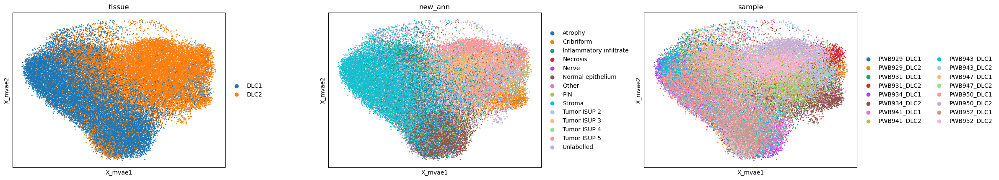

In [10]:
plot_embedding(model, mdata, train_params=train_params, poe_only=False)

### beta=0.1

In [10]:
train_params = TrainParams(add_lisi_loss=False, test_patience=100, train_size=0.8, n_epochs=100, learning_rate=1e-4, batch_size=128, params_file="mvae_beta0.1_gamma0")
model_params = ModelParams(beta=0.1, n_layers=2, z_dim=100, n_hidden=300, use_cuda=True)
torch.set_num_threads(16)
model = MVAE(mdata, model_params)

In [11]:
train_mvae(model, mdata, train_params,"sample")

Train data size: 33980
Test data size: 8495


100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.96it/s]

EarlyStopping (epoch: 1): train loss improved to 0.0559493708568436



100%|███████████████████████████████████████████| 67/67 [00:17<00:00,  3.91it/s]

EarlyStopping (epoch: 1): valid loss improved to 3.42443320288587



100%|█████████████████████████████████████████| 266/266 [01:06<00:00,  4.00it/s]

EarlyStopping (epoch: 2): train loss improved to 0.022864920528865407



100%|███████████████████████████████████████████| 67/67 [00:16<00:00,  4.04it/s]

EarlyStopping (epoch: 2): valid loss improved to 2.629501154173666



100%|███████████████████████████████████████████| 67/67 [00:16<00:00,  4.07it/s]

EarlyStopping (epoch: 3): valid loss improved to 2.3816378543626016



100%|███████████████████████████████████████████| 67/67 [00:16<00:00,  3.95it/s]

EarlyStopping (epoch: 4): valid loss improved to 2.2676727095646645



100%|███████████████████████████████████████████| 67/67 [00:16<00:00,  4.14it/s]

EarlyStopping (epoch: 5): valid loss improved to 2.1639945542634424



100%|███████████████████████████████████████████| 67/67 [00:16<00:00,  4.11it/s]

EarlyStopping (epoch: 6): valid loss improved to 2.1212129201462018



100%|███████████████████████████████████████████| 67/67 [00:16<00:00,  3.96it/s]

EarlyStopping (epoch: 7): valid loss improved to 2.081570614629717



100%|███████████████████████████████████████████| 67/67 [00:17<00:00,  3.93it/s]

EarlyStopping (epoch: 8): valid loss improved to 2.0477894615771164



100%|███████████████████████████████████████████| 67/67 [00:16<00:00,  3.98it/s]

EarlyStopping (epoch: 9): valid loss improved to 2.016777316136147



100%|███████████████████████████████████████████| 67/67 [00:18<00:00,  3.69it/s]

EarlyStopping (epoch: 10): valid loss improved to 1.9964424193795047



100%|███████████████████████████████████████████| 67/67 [00:17<00:00,  3.89it/s]

EarlyStopping (epoch: 11): valid loss improved to 1.9792003364705328



100%|█████████████████████████████████████████| 266/266 [01:05<00:00,  4.06it/s]

EarlyStopping (epoch: 12): train loss hasn't improved: 0.015682802163831902. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:17<00:00,  3.84it/s]

EarlyStopping (epoch: 12): valid loss improved to 1.9657292170311087



100%|█████████████████████████████████████████| 266/266 [01:11<00:00,  3.75it/s]

EarlyStopping (epoch: 13): train loss hasn't improved: 0.015591931781606018. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:16<00:00,  4.06it/s]

EarlyStopping (epoch: 13): valid loss improved to 1.9523916671525186



100%|█████████████████████████████████████████| 266/266 [01:10<00:00,  3.79it/s]

EarlyStopping (epoch: 14): train loss hasn't improved: 0.015504858243318079. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:17<00:00,  3.82it/s]

EarlyStopping (epoch: 14): valid loss improved to 1.9418216552307357



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.93it/s]

EarlyStopping (epoch: 15): train loss hasn't improved: 0.015441790775666172. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:18<00:00,  3.61it/s]

EarlyStopping (epoch: 15): valid loss improved to 1.93158798075434



100%|█████████████████████████████████████████| 266/266 [01:06<00:00,  4.03it/s]

EarlyStopping (epoch: 16): train loss hasn't improved: 0.01538944815172035. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.94it/s]

EarlyStopping (epoch: 17): train loss hasn't improved: 0.015326844909178503. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:17<00:00,  3.87it/s]

EarlyStopping (epoch: 17): valid loss improved to 1.9182079389913758



100%|█████████████████████████████████████████| 266/266 [01:10<00:00,  3.79it/s]

EarlyStopping (epoch: 18): train loss hasn't improved: 0.015270571430828236. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:10<00:00,  3.76it/s]

EarlyStopping (epoch: 19): train loss hasn't improved: 0.015239237153298578. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:08<00:00,  3.86it/s]

EarlyStopping (epoch: 20): train loss hasn't improved: 0.015206877774108923. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:16<00:00,  3.97it/s]

EarlyStopping (epoch: 20): valid loss improved to 1.9019832130688339



100%|█████████████████████████████████████████| 266/266 [01:08<00:00,  3.86it/s]

EarlyStopping (epoch: 21): train loss hasn't improved: 0.015179863619481626. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:08<00:00,  3.87it/s]

EarlyStopping (epoch: 22): train loss hasn't improved: 0.015139504002430216. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.93it/s]

EarlyStopping (epoch: 23): train loss hasn't improved: 0.015124675008814219. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:16<00:00,  4.06it/s]

EarlyStopping (epoch: 23): valid loss improved to 1.88940556547535



100%|█████████████████████████████████████████| 266/266 [01:08<00:00,  3.86it/s]

EarlyStopping (epoch: 24): train loss hasn't improved: 0.015102436168534817. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:14<00:00,  3.56it/s]

EarlyStopping (epoch: 25): train loss hasn't improved: 0.015087633511120604. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:10<00:00,  3.78it/s]

EarlyStopping (epoch: 26): train loss hasn't improved: 0.015069844755725063. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:08<00:00,  3.91it/s]

EarlyStopping (epoch: 27): train loss hasn't improved: 0.015043616010695081. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:17<00:00,  3.76it/s]

EarlyStopping (epoch: 27): valid loss improved to 1.877298383570429



100%|█████████████████████████████████████████| 266/266 [01:08<00:00,  3.88it/s]

EarlyStopping (epoch: 28): train loss hasn't improved: 0.015039605874044184. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:10<00:00,  3.78it/s]

EarlyStopping (epoch: 29): train loss hasn't improved: 0.015016275047905099. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.94it/s]

EarlyStopping (epoch: 30): train loss hasn't improved: 0.01501269416643494. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.93it/s]

EarlyStopping (epoch: 31): train loss hasn't improved: 0.014993118752164655. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:10<00:00,  3.77it/s]

EarlyStopping (epoch: 32): train loss hasn't improved: 0.014989772963481767. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:10<00:00,  3.75it/s]

EarlyStopping (epoch: 33): train loss hasn't improved: 0.014974034762228146. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:09<00:00,  3.85it/s]

EarlyStopping (epoch: 34): train loss hasn't improved: 0.014967368507188794. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.96it/s]

EarlyStopping (epoch: 35): train loss hasn't improved: 0.01495184449324403. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:16<00:00,  3.95it/s]

EarlyStopping (epoch: 35): valid loss improved to 1.8658464808962238



100%|█████████████████████████████████████████| 266/266 [01:08<00:00,  3.87it/s]

EarlyStopping (epoch: 36): train loss hasn't improved: 0.014947172997627909. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:10<00:00,  3.76it/s]

EarlyStopping (epoch: 37): train loss hasn't improved: 0.014936813962957731. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:09<00:00,  3.84it/s]

EarlyStopping (epoch: 38): train loss hasn't improved: 0.014944280151622025. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:11<00:00,  3.72it/s]

EarlyStopping (epoch: 39): train loss hasn't improved: 0.014924522074900914. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:05<00:00,  4.08it/s]

EarlyStopping (epoch: 40): train loss hasn't improved: 0.014922704571762669. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:05<00:00,  4.07it/s]

EarlyStopping (epoch: 41): train loss hasn't improved: 0.014913620357305741. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:06<00:00,  3.97it/s]

EarlyStopping (epoch: 42): train loss hasn't improved: 0.01491495879907479. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:10<00:00,  3.77it/s]

EarlyStopping (epoch: 43): train loss hasn't improved: 0.014904509641760724. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.93it/s]

EarlyStopping (epoch: 44): train loss hasn't improved: 0.014903265111512335. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:04<00:00,  4.14it/s]

EarlyStopping (epoch: 45): train loss hasn't improved: 0.014899958874493083. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.92it/s]

EarlyStopping (epoch: 46): train loss hasn't improved: 0.01489565916942666. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.95it/s]

EarlyStopping (epoch: 47): train loss hasn't improved: 0.014883372452484993. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:16<00:00,  4.03it/s]

EarlyStopping (epoch: 47): valid loss improved to 1.8547787684113233



100%|█████████████████████████████████████████| 266/266 [01:06<00:00,  3.98it/s]

EarlyStopping (epoch: 48): train loss hasn't improved: 0.014881729244694702. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:09<00:00,  3.84it/s]

EarlyStopping (epoch: 49): train loss hasn't improved: 0.014873784149022858. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:12<00:00,  3.69it/s]

EarlyStopping (epoch: 50): train loss hasn't improved: 0.01488334464633935. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:13<00:00,  3.64it/s]

EarlyStopping (epoch: 51): train loss hasn't improved: 0.014871235171649792. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.92it/s]

EarlyStopping (epoch: 52): train loss hasn't improved: 0.01487576288640885. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:06<00:00,  4.01it/s]

EarlyStopping (epoch: 53): train loss hasn't improved: 0.014861536955679074. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.95it/s]

EarlyStopping (epoch: 54): train loss hasn't improved: 0.014863005983892646. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:03<00:00,  4.22it/s]

EarlyStopping (epoch: 55): train loss hasn't improved: 0.014857075304196398. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:03<00:00,  4.16it/s]

EarlyStopping (epoch: 56): train loss hasn't improved: 0.014861838708139995. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:03<00:00,  4.21it/s]

EarlyStopping (epoch: 57): train loss hasn't improved: 0.014849735499129988. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:02<00:00,  4.24it/s]

EarlyStopping (epoch: 58): train loss hasn't improved: 0.014848807220812613. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:01<00:00,  4.33it/s]

EarlyStopping (epoch: 59): train loss hasn't improved: 0.014856027367537411. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:03<00:00,  4.17it/s]

EarlyStopping (epoch: 60): train loss hasn't improved: 0.014844473577233326. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:04<00:00,  4.13it/s]

EarlyStopping (epoch: 61): train loss hasn't improved: 0.014849942389342839. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:05<00:00,  4.07it/s]

EarlyStopping (epoch: 62): train loss hasn't improved: 0.014844892591922124. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:04<00:00,  4.09it/s]

EarlyStopping (epoch: 63): train loss hasn't improved: 0.01483461344291211. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:04<00:00,  4.14it/s]

EarlyStopping (epoch: 64): train loss hasn't improved: 0.014839740884240898. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:02<00:00,  4.24it/s]

EarlyStopping (epoch: 65): train loss hasn't improved: 0.014836581189047245. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:06<00:00,  4.01it/s]

EarlyStopping (epoch: 66): train loss hasn't improved: 0.014835851437348068. Stopping.



100%|█████████████████████████████████████████| 266/266 [00:59<00:00,  4.45it/s]

EarlyStopping (epoch: 67): train loss hasn't improved: 0.014837752183512283. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:06<00:00,  3.99it/s]

EarlyStopping (epoch: 68): train loss hasn't improved: 0.014834677636307643. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:04<00:00,  4.11it/s]

EarlyStopping (epoch: 69): train loss hasn't improved: 0.014824062582322469. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:00<00:00,  4.43it/s]

EarlyStopping (epoch: 70): train loss hasn't improved: 0.014827443488279884. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:04<00:00,  4.10it/s]

EarlyStopping (epoch: 71): train loss hasn't improved: 0.014825872897119506. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:04<00:00,  4.10it/s]

EarlyStopping (epoch: 72): train loss hasn't improved: 0.014823355430571594. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.94it/s]

EarlyStopping (epoch: 73): train loss hasn't improved: 0.014820146118633321. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:05<00:00,  4.08it/s]

EarlyStopping (epoch: 74): train loss hasn't improved: 0.01482597821736911. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:04<00:00,  4.15it/s]

EarlyStopping (epoch: 75): train loss hasn't improved: 0.014811292376638932. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:03<00:00,  4.18it/s]

EarlyStopping (epoch: 76): train loss hasn't improved: 0.014815550477733466. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:04<00:00,  4.15it/s]

EarlyStopping (epoch: 77): train loss hasn't improved: 0.01481925777437548. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:06<00:00,  4.01it/s]

EarlyStopping (epoch: 78): train loss hasn't improved: 0.014821010926248327. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:08<00:00,  3.91it/s]

EarlyStopping (epoch: 79): train loss hasn't improved: 0.014805629781023623. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:06<00:00,  4.01it/s]

EarlyStopping (epoch: 80): train loss hasn't improved: 0.01481384683034222. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:05<00:00,  4.06it/s]

EarlyStopping (epoch: 81): train loss hasn't improved: 0.01481533217177523. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.93it/s]

EarlyStopping (epoch: 82): train loss hasn't improved: 0.014809996724619873. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:06<00:00,  3.98it/s]

EarlyStopping (epoch: 83): train loss hasn't improved: 0.014807618562441283. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:06<00:00,  3.98it/s]

EarlyStopping (epoch: 84): train loss hasn't improved: 0.014807607522075354. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:05<00:00,  4.04it/s]

EarlyStopping (epoch: 85): train loss hasn't improved: 0.01480456314555612. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:06<00:00,  4.03it/s]

EarlyStopping (epoch: 86): train loss hasn't improved: 0.014803517215598534. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:05<00:00,  4.04it/s]

EarlyStopping (epoch: 87): train loss hasn't improved: 0.01480365365726096. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:05<00:00,  4.08it/s]

EarlyStopping (epoch: 88): train loss hasn't improved: 0.014794383949220285. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:05<00:00,  4.04it/s]

EarlyStopping (epoch: 89): train loss hasn't improved: 0.014801125073166298. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:02<00:00,  4.24it/s]

EarlyStopping (epoch: 90): train loss hasn't improved: 0.014795220599867724. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:02<00:00,  4.27it/s]

EarlyStopping (epoch: 91): train loss hasn't improved: 0.014805655229645944. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:03<00:00,  4.22it/s]

EarlyStopping (epoch: 92): train loss hasn't improved: 0.01480500229742332. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.96it/s]

EarlyStopping (epoch: 93): train loss hasn't improved: 0.014797594924054474. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:05<00:00,  4.06it/s]

EarlyStopping (epoch: 94): train loss hasn't improved: 0.014792755167227481. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:10<00:00,  3.78it/s]

EarlyStopping (epoch: 95): train loss hasn't improved: 0.014792918015256076. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.91it/s]

EarlyStopping (epoch: 96): train loss hasn't improved: 0.014790546718662525. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:07<00:00,  3.93it/s]

EarlyStopping (epoch: 97): train loss hasn't improved: 0.014786863235812667. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:05<00:00,  4.06it/s]

EarlyStopping (epoch: 98): train loss hasn't improved: 0.014790192325372006. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:06<00:00,  4.01it/s]

EarlyStopping (epoch: 99): train loss hasn't improved: 0.01479768148234762. Stopping.



100%|█████████████████████████████████████████| 266/266 [01:06<00:00,  4.02it/s]

EarlyStopping (epoch: 100): train loss hasn't improved: 0.014788429161041467. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:16<00:00,  4.02it/s]


{'train_loss': [0.0559493708568436,
  0.022864920528865407,
  0.019896995221396766,
  0.01848763111691534,
  0.017611323748707,
  0.017060277804407813,
  0.01668478608341902,
  0.01640504112378368,
  0.01617030875341832,
  0.015977167107905973,
  0.015824481236226002,
  0.015682802163831902,
  0.015591931781606018,
  0.015504858243318079,
  0.015441790775666172,
  0.01538944815172035,
  0.015326844909178503,
  0.015270571430828236,
  0.015239237153298578,
  0.015206877774108923,
  0.015179863619481626,
  0.015139504002430216,
  0.015124675008814219,
  0.015102436168534817,
  0.015087633511120604,
  0.015069844755725063,
  0.015043616010695081,
  0.015039605874044184,
  0.015016275047905099,
  0.01501269416643494,
  0.014993118752164655,
  0.014989772963481767,
  0.014974034762228146,
  0.014967368507188794,
  0.01495184449324403,
  0.014947172997627909,
  0.014936813962957731,
  0.014944280151622025,
  0.014924522074900914,
  0.014922704571762669,
  0.014913620357305741,
  0.0149149587

### No LISI, no KL on batch layers

In [9]:
train_params = TrainParams(test_patience=100, add_lisi_loss=False, train_size=0.8, n_epochs=100, learning_rate=1e-4, batch_size=128, params_file="mvae_beta0.01_gamma0")
model_params = ModelParams(beta=0.01, n_layers=2, z_dim=100, n_hidden=300, use_cuda=True)
torch.set_num_threads(16)
model = MVAE(mdata, model_params)

In [10]:
# train_mvae(model, mdata, train_params,"sample")
model.load_state_dict(torch.load("vae_params/mvae_beta0.01_gamma0_20230513-035004.pt"))

<All keys matched successfully>

100%|█████████████████████████████████████████| 332/332 [00:34<00:00,  9.50it/s]
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


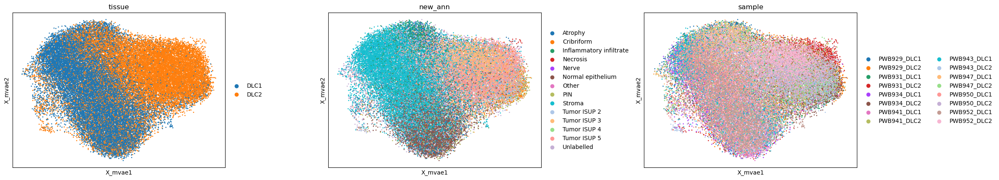

In [11]:
plot_embedding(model, mdata, train_params=train_params, poe_only=False)

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


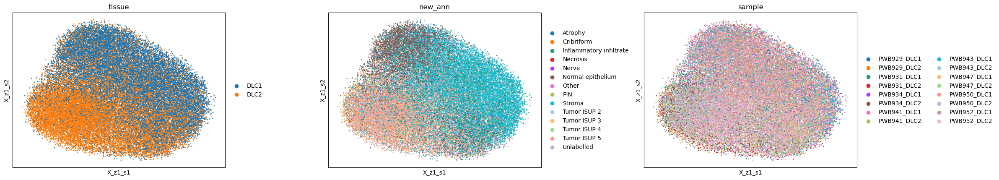

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


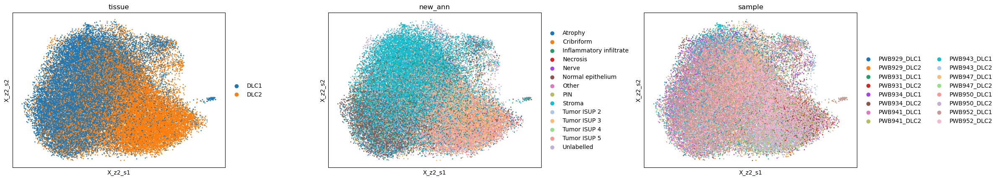

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


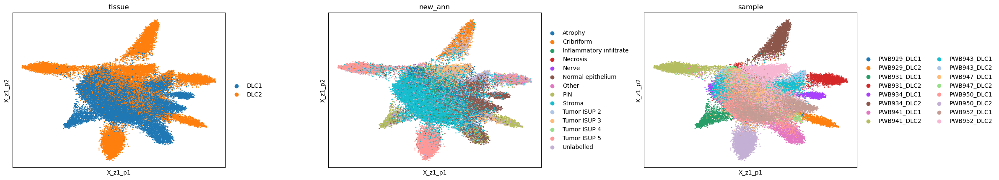

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


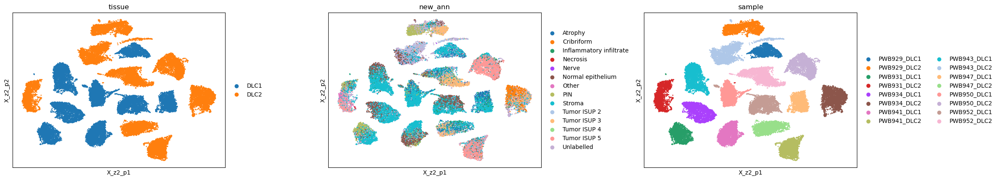

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


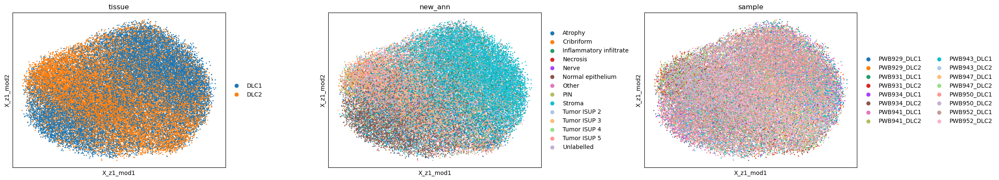

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


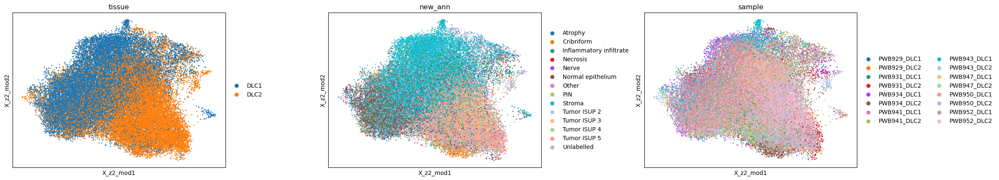

In [12]:
for layer in ["X_z1_s", "X_z2_s", "X_z1_p", "X_z2_p", "X_z1_mod", "X_z2_mod"]:
    sc.pl.embedding(
            mdata,
            layer,
            color=["tissue", "new_ann", "sample"],
            size=15,
            wspace=0.35,
        )

### beta=0.0001, gamma=0.0003

In [9]:
train_params = TrainParams(train_size=0.8, n_epochs=100, learning_rate=1e-4, batch_size=128, params_file="mvae_beta0.0001_gamma0.0003")
model_params = ModelParams(beta=0.0001, gamma=0.0003, n_layers=2, z_dim=100, n_hidden=300, use_cuda=True)
torch.set_num_threads(16)
model = MVAE(mdata, model_params)

In [10]:
train_mvae(model, mdata, train_params,"sample")

Train data size: 33980
Test data size: 8495


100%|█████████████████████████████████████████| 266/266 [05:15<00:00,  1.19s/it]

EarlyStopping (epoch: 1): train loss improved to 0.054989403931795675



100%|███████████████████████████████████████████| 67/67 [01:12<00:00,  1.09s/it]

EarlyStopping (epoch: 1): valid loss improved to 3.145589422823778



100%|█████████████████████████████████████████| 266/266 [05:06<00:00,  1.15s/it]

EarlyStopping (epoch: 2): train loss improved to 0.02170622621023213



100%|███████████████████████████████████████████| 67/67 [01:14<00:00,  1.11s/it]

EarlyStopping (epoch: 2): valid loss improved to 2.4668778661471693



100%|███████████████████████████████████████████| 67/67 [01:15<00:00,  1.13s/it]

EarlyStopping (epoch: 3): valid loss improved to 2.1831800795313137



100%|███████████████████████████████████████████| 67/67 [01:16<00:00,  1.15s/it]

EarlyStopping (epoch: 4): valid loss improved to 2.0391196226006123



100%|███████████████████████████████████████████| 67/67 [01:17<00:00,  1.16s/it]

EarlyStopping (epoch: 5): valid loss improved to 1.9467991181273958



100%|███████████████████████████████████████████| 67/67 [01:15<00:00,  1.13s/it]

EarlyStopping (epoch: 6): valid loss improved to 1.8932210046853593



100%|███████████████████████████████████████████| 67/67 [01:18<00:00,  1.18s/it]

EarlyStopping (epoch: 7): valid loss improved to 1.8442567711445823



100%|███████████████████████████████████████████| 67/67 [01:17<00:00,  1.16s/it]

EarlyStopping (epoch: 8): valid loss improved to 1.8208267315110165



100%|███████████████████████████████████████████| 67/67 [01:17<00:00,  1.16s/it]

EarlyStopping (epoch: 9): valid loss improved to 1.794783798616324



100%|███████████████████████████████████████████| 67/67 [01:17<00:00,  1.16s/it]

EarlyStopping (epoch: 10): valid loss improved to 1.7791333109585208



100%|███████████████████████████████████████████| 67/67 [01:18<00:00,  1.17s/it]

EarlyStopping (epoch: 11): valid loss improved to 1.7650350100958525



100%|███████████████████████████████████████████| 67/67 [01:18<00:00,  1.17s/it]

EarlyStopping (epoch: 12): valid loss improved to 1.7524959329348893



100%|█████████████████████████████████████████| 266/266 [05:25<00:00,  1.22s/it]

EarlyStopping (epoch: 13): train loss hasn't improved: 0.014276486508912237. Stopping.



100%|█████████████████████████████████████████| 266/266 [05:26<00:00,  1.23s/it]

EarlyStopping (epoch: 15): train loss hasn't improved: 0.014129930190860418. Stopping.



100%|█████████████████████████████████████████| 266/266 [05:24<00:00,  1.22s/it]

EarlyStopping (epoch: 16): train loss hasn't improved: 0.014081541140546792. Stopping.



100%|█████████████████████████████████████████| 266/266 [05:26<00:00,  1.23s/it]

EarlyStopping (epoch: 17): train loss hasn't improved: 0.014033131451379417. Stopping.



100%|█████████████████████████████████████████| 266/266 [05:23<00:00,  1.22s/it]

EarlyStopping (epoch: 18): train loss hasn't improved: 0.013988040990167115. Stopping.



100%|█████████████████████████████████████████| 266/266 [05:26<00:00,  1.23s/it]

EarlyStopping (epoch: 19): train loss hasn't improved: 0.013953348410136563. Stopping.



100%|█████████████████████████████████████████| 266/266 [05:26<00:00,  1.23s/it]

EarlyStopping (epoch: 20): train loss hasn't improved: 0.013923639788776372. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:14<00:00,  1.37it/s]

EarlyStopping (epoch: 21): train loss hasn't improved: 0.01389624582381021. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:43<00:00,  1.55it/s]

EarlyStopping (epoch: 21): valid loss improved to 1.6999538603113657



100%|█████████████████████████████████████████| 266/266 [03:14<00:00,  1.37it/s]

EarlyStopping (epoch: 22): train loss hasn't improved: 0.013868038846577807. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:13<00:00,  1.37it/s]

EarlyStopping (epoch: 23): train loss hasn't improved: 0.013862262468888102. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:14<00:00,  1.37it/s]

EarlyStopping (epoch: 24): train loss hasn't improved: 0.01383203393645396. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:13<00:00,  1.38it/s]

EarlyStopping (epoch: 25): train loss hasn't improved: 0.013809344917974309. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:13<00:00,  1.37it/s]

EarlyStopping (epoch: 26): train loss hasn't improved: 0.013791475989244628. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:43<00:00,  1.55it/s]

EarlyStopping (epoch: 27): valid loss improved to 1.6886944895360008



100%|█████████████████████████████████████████| 266/266 [03:14<00:00,  1.37it/s]

EarlyStopping (epoch: 28): train loss hasn't improved: 0.013760309734366935. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:14<00:00,  1.37it/s]

EarlyStopping (epoch: 29): train loss hasn't improved: 0.013753649516972884. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:14<00:00,  1.37it/s]

EarlyStopping (epoch: 30): train loss hasn't improved: 0.01373566170521804. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:13<00:00,  1.38it/s]

EarlyStopping (epoch: 31): train loss hasn't improved: 0.013730976874860613. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:13<00:00,  1.37it/s]

EarlyStopping (epoch: 32): train loss hasn't improved: 0.013713339688568834. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:13<00:00,  1.37it/s]

EarlyStopping (epoch: 33): train loss hasn't improved: 0.01371090593514827. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:14<00:00,  1.37it/s]

EarlyStopping (epoch: 34): train loss hasn't improved: 0.01370690440766737. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:14<00:00,  1.37it/s]

EarlyStopping (epoch: 35): train loss hasn't improved: 0.013693755591455945. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:13<00:00,  1.37it/s]

EarlyStopping (epoch: 36): train loss hasn't improved: 0.01368627934823533. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:13<00:00,  1.37it/s]

EarlyStopping (epoch: 37): train loss hasn't improved: 0.013683507763827247. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:13<00:00,  1.37it/s]

EarlyStopping (epoch: 38): train loss hasn't improved: 0.013676873851061007. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:11<00:00,  1.39it/s]

EarlyStopping (epoch: 39): train loss hasn't improved: 0.013676008604918598. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:13<00:00,  1.37it/s]

EarlyStopping (epoch: 40): train loss hasn't improved: 0.013669730067744263. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:13<00:00,  1.37it/s]

EarlyStopping (epoch: 41): train loss hasn't improved: 0.013656822925739389. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:15<00:00,  1.36it/s]

EarlyStopping (epoch: 42): train loss hasn't improved: 0.013650514680964586. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:13<00:00,  1.38it/s]

EarlyStopping (epoch: 43): train loss hasn't improved: 0.013647200834617818. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:12<00:00,  1.38it/s]

EarlyStopping (epoch: 44): train loss hasn't improved: 0.01364662017521962. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:13<00:00,  1.37it/s]

EarlyStopping (epoch: 45): train loss hasn't improved: 0.013642761414720424. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:13<00:00,  1.37it/s]

EarlyStopping (epoch: 46): train loss hasn't improved: 0.0136422267340435. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:13<00:00,  1.37it/s]

EarlyStopping (epoch: 47): train loss hasn't improved: 0.01363776858727184. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:42<00:00,  1.57it/s]

EarlyStopping (epoch: 47): valid loss hasn't improved: 1.6769655551483382. Stopping.


{'train_loss': [0.054989403931795675,
  0.02170622621023213,
  0.01862871085566026,
  0.017072084207546016,
  0.0162067496299463,
  0.015640684532515787,
  0.015247292266725582,
  0.014969930398316858,
  0.014743312616219164,
  0.014603640483785476,
  0.014474395666492905,
  0.014365754722496423,
  0.014276486508912237,
  0.014203265553155039,
  0.014129930190860418,
  0.014081541140546792,
  0.014033131451379417,
  0.013988040990167115,
  0.013953348410136563,
  0.013923639788776372,
  0.01389624582381021,
  0.013868038846577807,
  0.013862262468888102,
  0.01383203393645396,
  0.013809344917974309,
  0.013791475989244628,
  0.01378110542305783,
  0.013760309734366935,
  0.013753649516972884,
  0.01373566170521804,
  0.013730976874860613,
  0.013713339688568834,
  0.01371090593514827,
  0.01370690440766737,
  0.013693755591455945,
  0.01368627934823533,
  0.013683507763827247,
  0.013676873851061007,
  0.013676008604918598,
  0.013669730067744263,
  0.013656822925739389,
  0.013650514

In [ ]:
plot_embedding(model, mdata, train_params=train_params, poe_only=False)

### beta=0.001, gamma=0.0003

In [9]:
train_params = TrainParams(train_size=0.8, test_patience=100, n_epochs=100, learning_rate=1e-4, batch_size=128, params_file="mvae_beta0.001_gamma0.0003_epoch100")
model_params = ModelParams(beta=0.001, gamma=0.0003, n_layers=2, z_dim=100, n_hidden=300, use_cuda=True)
torch.set_num_threads(16)
model = MVAE(mdata, model_params)

In [ ]:
train_mvae(model, mdata, train_params,"sample")
# model.load_state_dict(torch.load("vae_params/mvae_beta0.001_gamma0.0003_20230505-024100.pt"))

Train data size: 33980
Test data size: 8495


100%|█████████████████████████████████████████| 266/266 [03:05<00:00,  1.44it/s]

EarlyStopping (epoch: 1): train loss improved to 0.05475707775428058



100%|███████████████████████████████████████████| 67/67 [00:39<00:00,  1.68it/s]

EarlyStopping (epoch: 1): valid loss improved to 3.2010919015798995



100%|█████████████████████████████████████████| 266/266 [03:06<00:00,  1.43it/s]

EarlyStopping (epoch: 2): train loss improved to 0.0217872982378775



100%|███████████████████████████████████████████| 67/67 [00:40<00:00,  1.64it/s]

EarlyStopping (epoch: 2): valid loss improved to 2.4976173479165604



100%|███████████████████████████████████████████| 67/67 [00:41<00:00,  1.63it/s]

EarlyStopping (epoch: 3): valid loss improved to 2.198995259270739



100%|███████████████████████████████████████████| 67/67 [00:41<00:00,  1.61it/s]

EarlyStopping (epoch: 4): valid loss improved to 2.049150112849563



100%|███████████████████████████████████████████| 67/67 [00:41<00:00,  1.60it/s]

EarlyStopping (epoch: 5): valid loss improved to 1.9589484591982258



100%|███████████████████████████████████████████| 67/67 [00:41<00:00,  1.60it/s]

EarlyStopping (epoch: 6): valid loss improved to 1.8990263743187064



100%|███████████████████████████████████████████| 67/67 [00:41<00:00,  1.61it/s]

EarlyStopping (epoch: 7): valid loss improved to 1.8529126270493466



100%|███████████████████████████████████████████| 67/67 [00:41<00:00,  1.60it/s]

EarlyStopping (epoch: 8): valid loss improved to 1.8283314313461532



100%|███████████████████████████████████████████| 67/67 [00:42<00:00,  1.59it/s]

EarlyStopping (epoch: 9): valid loss improved to 1.8016750954869967



100%|███████████████████████████████████████████| 67/67 [00:41<00:00,  1.60it/s]

EarlyStopping (epoch: 10): valid loss improved to 1.7882654506768754



100%|███████████████████████████████████████████| 67/67 [00:42<00:00,  1.59it/s]

EarlyStopping (epoch: 11): valid loss improved to 1.7721539397737873



100%|█████████████████████████████████████████| 266/266 [03:11<00:00,  1.39it/s]

EarlyStopping (epoch: 12): train loss hasn't improved: 0.014376649802540806. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:42<00:00,  1.59it/s]

EarlyStopping (epoch: 12): valid loss improved to 1.7599485454274648



100%|█████████████████████████████████████████| 266/266 [03:12<00:00,  1.38it/s]

EarlyStopping (epoch: 13): train loss hasn't improved: 0.014287627943127629. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:12<00:00,  1.38it/s]

EarlyStopping (epoch: 14): train loss hasn't improved: 0.01422153398385814. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:42<00:00,  1.59it/s]

EarlyStopping (epoch: 14): valid loss improved to 1.7434687596648486



100%|█████████████████████████████████████████| 266/266 [03:13<00:00,  1.37it/s]

EarlyStopping (epoch: 15): train loss hasn't improved: 0.014151487794604423. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:13<00:00,  1.37it/s]

EarlyStopping (epoch: 16): train loss hasn't improved: 0.014106035229035726. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:41<00:00,  1.60it/s]

EarlyStopping (epoch: 16): valid loss improved to 1.7287210297228686



100%|█████████████████████████████████████████| 266/266 [03:13<00:00,  1.38it/s]

EarlyStopping (epoch: 17): train loss hasn't improved: 0.014058431174349547. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:12<00:00,  1.38it/s]

EarlyStopping (epoch: 19): train loss hasn't improved: 0.01397428115092003. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:42<00:00,  1.59it/s]

EarlyStopping (epoch: 19): valid loss improved to 1.7133101883219248



100%|█████████████████████████████████████████| 266/266 [03:12<00:00,  1.38it/s]

EarlyStopping (epoch: 20): train loss hasn't improved: 0.013947608966978947. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:12<00:00,  1.38it/s]

EarlyStopping (epoch: 21): train loss hasn't improved: 0.013919568075861491. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:14<00:00,  1.37it/s]

EarlyStopping (epoch: 22): train loss hasn't improved: 0.013904527726069557. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:12<00:00,  1.38it/s]

EarlyStopping (epoch: 23): train loss hasn't improved: 0.013879690460066995. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:41<00:00,  1.60it/s]

EarlyStopping (epoch: 23): valid loss improved to 1.7029609591213626



100%|█████████████████████████████████████████| 266/266 [03:12<00:00,  1.38it/s]

EarlyStopping (epoch: 24): train loss hasn't improved: 0.013846105158223763. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:12<00:00,  1.38it/s]

EarlyStopping (epoch: 25): train loss hasn't improved: 0.01384081427597733. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:12<00:00,  1.38it/s]

EarlyStopping (epoch: 26): train loss hasn't improved: 0.01382919410665713. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:12<00:00,  1.38it/s]

EarlyStopping (epoch: 27): train loss hasn't improved: 0.013807925338110831. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:12<00:00,  1.38it/s]

EarlyStopping (epoch: 28): train loss hasn't improved: 0.013792677396462201. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:11<00:00,  1.39it/s]

EarlyStopping (epoch: 29): train loss hasn't improved: 0.013784566298872671. Stopping.



  0%|                                                   | 0/266 [00:00<?, ?it/s]

In [ ]:
plot_embedding(model, mdata, train_params=train_params, poe_only=False)

In [ ]:
for layer in ["X_z1_s", "X_z2_s", "X_z1_p", "X_z2_p", "X_z1_mod", "X_z2_mod"]:
    sc.pl.embedding(
            mdata,
            layer,
            color=["tissue", "new_ann", "sample"],
            size=15,
            wspace=0.35,
        )

### beta=0.001, gamma=0.0005

In [11]:
train_params = TrainParams(train_size=0.8, test_patience=100, n_epochs=100, learning_rate=1e-4, batch_size=128, params_file="mvae_beta0.001_gamma0.0005_epoch100")
model_params = ModelParams(beta=0.001, gamma=0.0005, n_layers=2, z_dim=100, n_hidden=300, use_cuda=True)
torch.set_num_threads(16)
model = MVAE(mdata, model_params)

In [12]:
train_mvae(model, mdata, train_params,"sample")

Train data size: 33980
Test data size: 8495


100%|█████████████████████████████████████████| 266/266 [03:11<00:00,  1.39it/s]

EarlyStopping (epoch: 1): train loss improved to 0.05490459348960369



100%|███████████████████████████████████████████| 67/67 [00:41<00:00,  1.63it/s]

EarlyStopping (epoch: 1): valid loss improved to 3.1588920443805297



100%|█████████████████████████████████████████| 266/266 [03:08<00:00,  1.41it/s]

EarlyStopping (epoch: 2): train loss improved to 0.021352868125044368



100%|███████████████████████████████████████████| 67/67 [00:44<00:00,  1.52it/s]

EarlyStopping (epoch: 2): valid loss improved to 2.4169446674745476



100%|███████████████████████████████████████████| 67/67 [00:42<00:00,  1.57it/s]

EarlyStopping (epoch: 3): valid loss improved to 2.169977277072508



100%|███████████████████████████████████████████| 67/67 [00:42<00:00,  1.57it/s]

EarlyStopping (epoch: 4): valid loss improved to 2.026917760051898



100%|███████████████████████████████████████████| 67/67 [00:42<00:00,  1.56it/s]

EarlyStopping (epoch: 5): valid loss improved to 1.9485380204755869



100%|███████████████████████████████████████████| 67/67 [00:42<00:00,  1.56it/s]

EarlyStopping (epoch: 6): valid loss improved to 1.8906235908394429



100%|███████████████████████████████████████████| 67/67 [00:43<00:00,  1.55it/s]

EarlyStopping (epoch: 7): valid loss improved to 1.849412565800681



100%|███████████████████████████████████████████| 67/67 [00:42<00:00,  1.57it/s]

EarlyStopping (epoch: 8): valid loss improved to 1.8204261598302358



100%|███████████████████████████████████████████| 67/67 [00:42<00:00,  1.56it/s]

EarlyStopping (epoch: 9): valid loss improved to 1.803401468405083



100%|███████████████████████████████████████████| 67/67 [00:42<00:00,  1.56it/s]

EarlyStopping (epoch: 10): valid loss improved to 1.7812663014255352



100%|███████████████████████████████████████████| 67/67 [00:42<00:00,  1.57it/s]

EarlyStopping (epoch: 11): valid loss improved to 1.7705250266772599



100%|█████████████████████████████████████████| 266/266 [03:14<00:00,  1.36it/s]

EarlyStopping (epoch: 12): train loss hasn't improved: 0.014383318923795272. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:43<00:00,  1.55it/s]

EarlyStopping (epoch: 12): valid loss improved to 1.75730847778605



100%|█████████████████████████████████████████| 266/266 [03:13<00:00,  1.38it/s]

EarlyStopping (epoch: 13): train loss hasn't improved: 0.014301691292453471. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:14<00:00,  1.37it/s]

EarlyStopping (epoch: 14): train loss hasn't improved: 0.014218727411979644. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:43<00:00,  1.55it/s]

EarlyStopping (epoch: 14): valid loss improved to 1.7416424342055818



100%|█████████████████████████████████████████| 266/266 [03:13<00:00,  1.38it/s]

EarlyStopping (epoch: 15): train loss hasn't improved: 0.014174082270083953. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:14<00:00,  1.37it/s]

EarlyStopping (epoch: 16): train loss hasn't improved: 0.014115518110509899. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:42<00:00,  1.57it/s]

EarlyStopping (epoch: 16): valid loss improved to 1.7298742283636064



100%|█████████████████████████████████████████| 266/266 [03:12<00:00,  1.38it/s]

EarlyStopping (epoch: 17): train loss hasn't improved: 0.014068802522869234. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:13<00:00,  1.37it/s]

EarlyStopping (epoch: 18): train loss hasn't improved: 0.01403554919679562. Stopping.



100%|█████████████████████████████████████████| 266/266 [04:12<00:00,  1.05it/s]

EarlyStopping (epoch: 19): train loss hasn't improved: 0.01400355292180484. Stopping.



100%|███████████████████████████████████████████| 67/67 [01:20<00:00,  1.20s/it]

EarlyStopping (epoch: 19): valid loss improved to 1.714245862035609



100%|█████████████████████████████████████████| 266/266 [05:30<00:00,  1.24s/it]

EarlyStopping (epoch: 20): train loss hasn't improved: 0.013980939708926384. Stopping.



100%|█████████████████████████████████████████| 266/266 [05:35<00:00,  1.26s/it]

EarlyStopping (epoch: 21): train loss hasn't improved: 0.013936757178359904. Stopping.



100%|█████████████████████████████████████████| 266/266 [05:34<00:00,  1.26s/it]

EarlyStopping (epoch: 22): train loss hasn't improved: 0.013929868084743066. Stopping.



100%|█████████████████████████████████████████| 266/266 [05:36<00:00,  1.26s/it]

EarlyStopping (epoch: 23): train loss hasn't improved: 0.013908511828225525. Stopping.



100%|█████████████████████████████████████████| 266/266 [05:36<00:00,  1.27s/it]

EarlyStopping (epoch: 24): train loss hasn't improved: 0.013890318876859228. Stopping.



100%|█████████████████████████████████████████| 266/266 [05:37<00:00,  1.27s/it]

EarlyStopping (epoch: 25): train loss hasn't improved: 0.013858646817457122. Stopping.



100%|███████████████████████████████████████████| 67/67 [01:20<00:00,  1.20s/it]

EarlyStopping (epoch: 25): valid loss improved to 1.6984644131873972



100%|█████████████████████████████████████████| 266/266 [05:42<00:00,  1.29s/it]

EarlyStopping (epoch: 26): train loss hasn't improved: 0.013849005978411965. Stopping.



100%|█████████████████████████████████████████| 266/266 [05:44<00:00,  1.29s/it]

EarlyStopping (epoch: 27): train loss hasn't improved: 0.013845593291496514. Stopping.



100%|█████████████████████████████████████████| 266/266 [05:37<00:00,  1.27s/it]

EarlyStopping (epoch: 28): train loss hasn't improved: 0.013821285415776272. Stopping.



100%|█████████████████████████████████████████| 266/266 [05:40<00:00,  1.28s/it]

EarlyStopping (epoch: 29): train loss hasn't improved: 0.01381336025731433. Stopping.



100%|█████████████████████████████████████████| 266/266 [05:42<00:00,  1.29s/it]

EarlyStopping (epoch: 30): train loss hasn't improved: 0.013808642246219395. Stopping.



100%|█████████████████████████████████████████| 266/266 [05:35<00:00,  1.26s/it]

EarlyStopping (epoch: 31): train loss hasn't improved: 0.013793526160990652. Stopping.



100%|█████████████████████████████████████████| 266/266 [05:35<00:00,  1.26s/it]

EarlyStopping (epoch: 32): train loss hasn't improved: 0.013787154063117582. Stopping.



100%|█████████████████████████████████████████| 266/266 [05:35<00:00,  1.26s/it]

EarlyStopping (epoch: 33): train loss hasn't improved: 0.013758162307767323. Stopping.



100%|█████████████████████████████████████████| 266/266 [05:35<00:00,  1.26s/it]

EarlyStopping (epoch: 34): train loss hasn't improved: 0.013772260072723847. Stopping.



100%|███████████████████████████████████████████| 67/67 [01:21<00:00,  1.21s/it]

EarlyStopping (epoch: 34): valid loss improved to 1.687549587505967



100%|█████████████████████████████████████████| 266/266 [05:35<00:00,  1.26s/it]

EarlyStopping (epoch: 35): train loss hasn't improved: 0.01376373091117293. Stopping.



100%|█████████████████████████████████████████| 266/266 [05:35<00:00,  1.26s/it]

EarlyStopping (epoch: 36): train loss hasn't improved: 0.013747534543503867. Stopping.



100%|█████████████████████████████████████████| 266/266 [05:35<00:00,  1.26s/it]

EarlyStopping (epoch: 37): train loss hasn't improved: 0.013748846803432777. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:16<00:00,  1.36it/s]

EarlyStopping (epoch: 38): train loss hasn't improved: 0.013737939437604638. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:15<00:00,  1.36it/s]

EarlyStopping (epoch: 39): train loss hasn't improved: 0.013738883081922256. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:15<00:00,  1.36it/s]

EarlyStopping (epoch: 40): train loss hasn't improved: 0.013720512677810695. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:14<00:00,  1.37it/s]

EarlyStopping (epoch: 41): train loss hasn't improved: 0.013721847421916672. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:14<00:00,  1.36it/s]

EarlyStopping (epoch: 42): train loss hasn't improved: 0.013718266782513642. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:14<00:00,  1.36it/s]

EarlyStopping (epoch: 43): train loss hasn't improved: 0.013721615889971926. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:14<00:00,  1.37it/s]

EarlyStopping (epoch: 44): train loss hasn't improved: 0.013716503435755702. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:15<00:00,  1.36it/s]

EarlyStopping (epoch: 45): train loss hasn't improved: 0.013710850263217255. Stopping.



 14%|█████▋                                    | 36/266 [00:28<02:44,  1.40it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

100%|█████████████████████████████████████████| 266/266 [03:14<00:00,  1.36it/s]

EarlyStopping (epoch: 97): train loss hasn't improved: 0.01362199167281898. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:13<00:00,  1.37it/s]

EarlyStopping (epoch: 98): train loss hasn't improved: 0.013613649323942241. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:14<00:00,  1.37it/s]

EarlyStopping (epoch: 99): train loss hasn't improved: 0.01361587634852804. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:14<00:00,  1.37it/s]

EarlyStopping (epoch: 100): train loss hasn't improved: 0.013612490124110267. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:42<00:00,  1.57it/s]


{'train_loss': [0.05490459348960369,
  0.021352868125044368,
  0.01841183150074214,
  0.01697412003763568,
  0.016143999333378848,
  0.01562316861133003,
  0.015257816433275076,
  0.014966335820758812,
  0.014764444094113984,
  0.014602640665861493,
  0.014486644189451777,
  0.014383318923795272,
  0.014301691292453471,
  0.014218727411979644,
  0.014174082270083953,
  0.014115518110509899,
  0.014068802522869234,
  0.01403554919679562,
  0.01400355292180484,
  0.013980939708926384,
  0.013936757178359904,
  0.013929868084743066,
  0.013908511828225525,
  0.013890318876859228,
  0.013858646817457122,
  0.013849005978411965,
  0.013845593291496514,
  0.013821285415776272,
  0.01381336025731433,
  0.013808642246219395,
  0.013793526160990652,
  0.013787154063117582,
  0.013758162307767323,
  0.013772260072723847,
  0.01376373091117293,
  0.013747534543503867,
  0.013748846803432777,
  0.013737939437604638,
  0.013738883081922256,
  0.013720512677810695,
  0.013721847421916672,
  0.013718

In [ ]:
plot_embedding(model, mdata, train_params=train_params, poe_only=False)

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


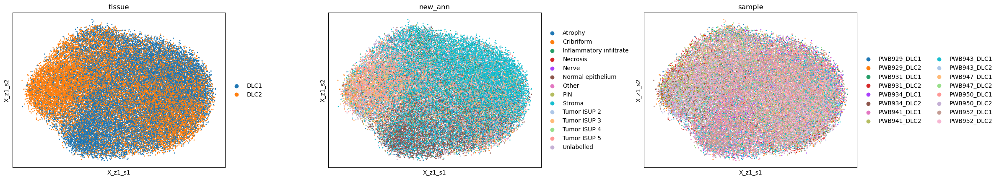

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


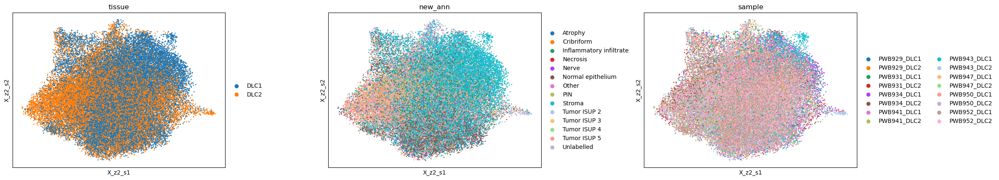

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


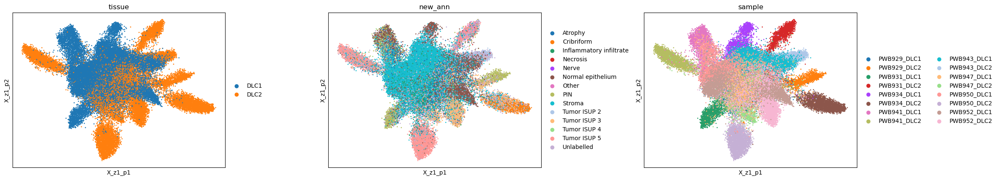

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


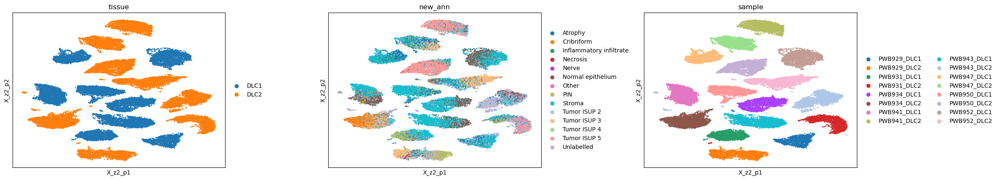

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


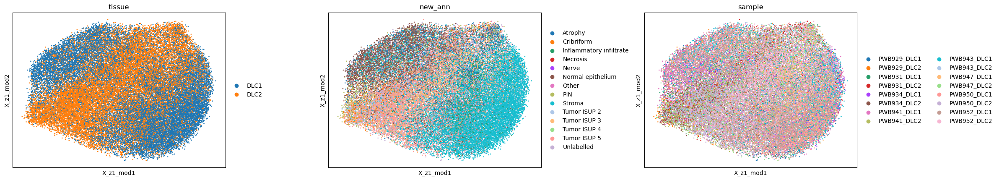

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


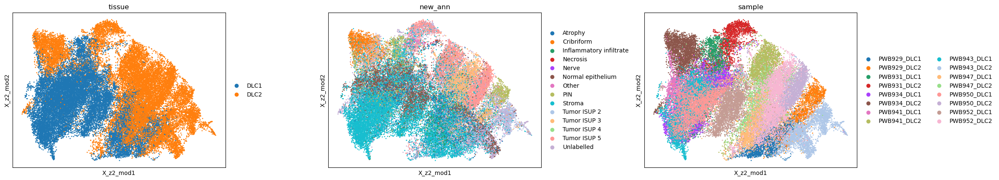

In [66]:
for layer in ["X_z1_s", "X_z2_s", "X_z1_p", "X_z2_p", "X_z1_mod", "X_z2_mod"]:
    sc.pl.embedding(
            mdata,
            layer,
            color=["tissue", "new_ann", "sample"],
            size=15,
            wspace=0.35,
        )

### beta=0.001, gamma=0.0001

In [20]:
train_params = TrainParams(train_size=0.8, test_patience=100, n_epochs=100, learning_rate=1e-4, batch_size=128, params_file="mvae_beta0.001_gamma0.0001_epoch100")
model_params = ModelParams(beta=0.001, gamma=0.0001, n_layers=2, z_dim=100, n_hidden=300, use_cuda=True)
torch.set_num_threads(16)
model = MVAE(mdata, model_params)

In [ ]:
train_mvae(model, mdata, train_params,"sample")

Train data size: 33980
Test data size: 8495


100%|█████████████████████████████████████████| 266/266 [03:13<00:00,  1.38it/s]

EarlyStopping (epoch: 1): train loss improved to 0.05491192753417412



100%|███████████████████████████████████████████| 67/67 [00:42<00:00,  1.58it/s]

EarlyStopping (epoch: 1): valid loss improved to 3.159072007705916



100%|█████████████████████████████████████████| 266/266 [03:05<00:00,  1.44it/s]

EarlyStopping (epoch: 2): train loss improved to 0.02174401965261979



100%|███████████████████████████████████████████| 67/67 [00:43<00:00,  1.56it/s]

EarlyStopping (epoch: 2): valid loss improved to 2.4755985558922613



100%|███████████████████████████████████████████| 67/67 [00:43<00:00,  1.55it/s]

EarlyStopping (epoch: 3): valid loss improved to 2.193886870768533



100%|███████████████████████████████████████████| 67/67 [00:43<00:00,  1.54it/s]

EarlyStopping (epoch: 4): valid loss improved to 2.033260984207267



100%|███████████████████████████████████████████| 67/67 [00:43<00:00,  1.53it/s]

EarlyStopping (epoch: 5): valid loss improved to 1.9553369212506422



100%|███████████████████████████████████████████| 67/67 [00:43<00:00,  1.54it/s]

EarlyStopping (epoch: 6): valid loss improved to 1.892941101273494



100%|███████████████████████████████████████████| 67/67 [00:43<00:00,  1.54it/s]

EarlyStopping (epoch: 7): valid loss improved to 1.8498114187326005



100%|███████████████████████████████████████████| 67/67 [00:43<00:00,  1.53it/s]

EarlyStopping (epoch: 8): valid loss improved to 1.8188873209170442



100%|███████████████████████████████████████████| 67/67 [00:44<00:00,  1.52it/s]

EarlyStopping (epoch: 9): valid loss improved to 1.795306321400315



100%|███████████████████████████████████████████| 67/67 [00:44<00:00,  1.52it/s]

EarlyStopping (epoch: 10): valid loss improved to 1.7787227114634727



100%|███████████████████████████████████████████| 67/67 [00:44<00:00,  1.52it/s]

EarlyStopping (epoch: 11): valid loss improved to 1.764165509992571



100%|█████████████████████████████████████████| 266/266 [03:07<00:00,  1.42it/s]

EarlyStopping (epoch: 12): train loss hasn't improved: 0.014365898359516497. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:07<00:00,  1.42it/s]

EarlyStopping (epoch: 13): train loss hasn't improved: 0.014275329596439202. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:43<00:00,  1.53it/s]

EarlyStopping (epoch: 13): valid loss improved to 1.7454284198248564



100%|█████████████████████████████████████████| 266/266 [03:10<00:00,  1.40it/s]

EarlyStopping (epoch: 14): train loss hasn't improved: 0.01418680849322296. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:44<00:00,  1.52it/s]

EarlyStopping (epoch: 14): valid loss improved to 1.7320973214818471



100%|█████████████████████████████████████████| 266/266 [03:10<00:00,  1.39it/s]

EarlyStopping (epoch: 15): train loss hasn't improved: 0.01412235872053693. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:09<00:00,  1.40it/s]

EarlyStopping (epoch: 16): train loss hasn't improved: 0.014075569954951277. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:09<00:00,  1.40it/s]

EarlyStopping (epoch: 17): train loss hasn't improved: 0.014027290490881845. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:43<00:00,  1.54it/s]

EarlyStopping (epoch: 17): valid loss improved to 1.7210615535280598



100%|█████████████████████████████████████████| 266/266 [03:09<00:00,  1.40it/s]

EarlyStopping (epoch: 18): train loss hasn't improved: 0.013992579096271544. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:09<00:00,  1.40it/s]

EarlyStopping (epoch: 19): train loss hasn't improved: 0.01394496306803312. Stopping.



100%|███████████████████████████████████████████| 67/67 [00:43<00:00,  1.54it/s]

EarlyStopping (epoch: 19): valid loss improved to 1.7063984283760412



100%|█████████████████████████████████████████| 266/266 [03:08<00:00,  1.41it/s]

EarlyStopping (epoch: 20): train loss hasn't improved: 0.013921424671086653. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:09<00:00,  1.40it/s]

EarlyStopping (epoch: 21): train loss hasn't improved: 0.013901110769651299. Stopping.



100%|█████████████████████████████████████████| 266/266 [03:08<00:00,  1.41it/s]

EarlyStopping (epoch: 22): train loss hasn't improved: 0.01387794270383533. Stopping.



 11%|████▍                                     | 28/266 [00:24<02:42,  1.47it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [ ]:
plot_embedding(model, mdata, train_params=train_params, poe_only=False)

In [ ]:
for layer in ["X_z1_s", "X_z2_s", "X_z1_p", "X_z2_p", "X_z1_mod", "X_z2_mod"]:
    sc.pl.embedding(
            mdata,
            layer,
            color=["tissue", "new_ann", "sample"],
            size=15,
            wspace=0.35,
        )

### beta=0.001, gamma=0.01

In [40]:
train_params = TrainParams(train_size=0.8, n_epochs=100, learning_rate=1e-4, batch_size=128, params_file="mvae_beta0.001_gamma0.01")
model_params = ModelParams(beta=0.001, gamma=0.01, n_layers=2, z_dim=100, n_hidden=300, use_cuda=True)
torch.set_num_threads(16)
model = MVAE(mdata, model_params)

In [41]:
train_mvae(model, mdata, train_params,"sample")

Train data size: 33980
Test data size: 8495


100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:56<00:00,  1.51it/s]

EarlyStopping (epoch: 1): train loss improved to 0.07233094181152847



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:40<00:00,  1.65it/s]

EarlyStopping (epoch: 1): valid loss improved to 4.200312742546423



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:53<00:00,  1.54it/s]

EarlyStopping (epoch: 2): train loss improved to 0.028985130379942322



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:40<00:00,  1.64it/s]

EarlyStopping (epoch: 2): valid loss improved to 3.3387959003448486



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:41<00:00,  1.62it/s]

EarlyStopping (epoch: 3): valid loss improved to 2.962166444579167



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:41<00:00,  1.63it/s]

EarlyStopping (epoch: 4): valid loss improved to 2.739027863118186



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:41<00:00,  1.63it/s]

EarlyStopping (epoch: 5): valid loss improved to 2.6078080241359882



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:41<00:00,  1.62it/s]

EarlyStopping (epoch: 6): valid loss improved to 2.519014433248719



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:41<00:00,  1.63it/s]

EarlyStopping (epoch: 7): valid loss improved to 2.4604695804083527



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:41<00:00,  1.61it/s]

EarlyStopping (epoch: 8): valid loss improved to 2.412849130915172



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:41<00:00,  1.62it/s]

EarlyStopping (epoch: 9): valid loss improved to 2.3822780367153795



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:40<00:00,  1.65it/s]

EarlyStopping (epoch: 10): valid loss improved to 2.351866757691796



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:41<00:00,  1.62it/s]

EarlyStopping (epoch: 11): valid loss improved to 2.3344583724861714



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:55<00:00,  1.51it/s]

EarlyStopping (epoch: 12): train loss improved to 0.018897465736182596



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:41<00:00,  1.62it/s]

EarlyStopping (epoch: 12): valid loss improved to 2.3192278449215107



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:41<00:00,  1.63it/s]

EarlyStopping (epoch: 13): valid loss improved to 2.2991583703169183



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:41<00:00,  1.61it/s]

EarlyStopping (epoch: 15): valid loss improved to 2.282065327487775



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:41<00:00,  1.61it/s]

EarlyStopping (epoch: 17): valid loss improved to 2.2568056227555915



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:41<00:00,  1.61it/s]

EarlyStopping (epoch: 20): valid loss improved to 2.238832726407407



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:56<00:00,  1.50it/s]

EarlyStopping (epoch: 22): train loss hasn't improved: 0.018173516491288785. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:57<00:00,  1.50it/s]

EarlyStopping (epoch: 23): train loss hasn't improved: 0.01814112750974524. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:57<00:00,  1.50it/s]

EarlyStopping (epoch: 24): train loss hasn't improved: 0.018107330146574004. Stopping.



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:41<00:00,  1.62it/s]

EarlyStopping (epoch: 24): valid loss improved to 2.2266880078102225



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:56<00:00,  1.51it/s]

EarlyStopping (epoch: 25): train loss hasn't improved: 0.01809046450890535. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:57<00:00,  1.50it/s]

EarlyStopping (epoch: 26): train loss hasn't improved: 0.0180505639739146. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:57<00:00,  1.50it/s]

EarlyStopping (epoch: 27): train loss hasn't improved: 0.018022525913930065. Stopping.



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:42<00:00,  1.59it/s]

EarlyStopping (epoch: 27): valid loss improved to 2.216057119084828



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:57<00:00,  1.50it/s]

EarlyStopping (epoch: 28): train loss hasn't improved: 0.018017744154983438. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:56<00:00,  1.50it/s]

EarlyStopping (epoch: 29): train loss hasn't improved: 0.01799848177911535. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:56<00:00,  1.51it/s]

EarlyStopping (epoch: 30): train loss hasn't improved: 0.017957469194759126. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:56<00:00,  1.51it/s]

EarlyStopping (epoch: 31): train loss hasn't improved: 0.017963598018677675. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:55<00:00,  1.51it/s]

EarlyStopping (epoch: 32): train loss hasn't improved: 0.017944229961213396. Stopping.



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:41<00:00,  1.62it/s]

EarlyStopping (epoch: 32): valid loss improved to 2.2050139085570377



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:55<00:00,  1.52it/s]

EarlyStopping (epoch: 33): train loss hasn't improved: 0.01793799225620272. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:56<00:00,  1.51it/s]

EarlyStopping (epoch: 34): train loss hasn't improved: 0.01791567624211662. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:55<00:00,  1.52it/s]

EarlyStopping (epoch: 35): train loss hasn't improved: 0.017902971485771104. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:56<00:00,  1.51it/s]

EarlyStopping (epoch: 36): train loss hasn't improved: 0.01789053839890658. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:56<00:00,  1.51it/s]

EarlyStopping (epoch: 37): train loss hasn't improved: 0.017880623680202313. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:55<00:00,  1.52it/s]

EarlyStopping (epoch: 38): train loss hasn't improved: 0.017868423946048317. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:54<00:00,  1.52it/s]

EarlyStopping (epoch: 39): train loss hasn't improved: 0.01786237473064061. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:55<00:00,  1.52it/s]

EarlyStopping (epoch: 40): train loss hasn't improved: 0.017843333933899305. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:55<00:00,  1.52it/s]

EarlyStopping (epoch: 41): train loss hasn't improved: 0.017835088061051482. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:56<00:00,  1.51it/s]

EarlyStopping (epoch: 42): train loss hasn't improved: 0.01783713103042342. Stopping.



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:41<00:00,  1.63it/s]

EarlyStopping (epoch: 42): valid loss improved to 2.189154614263506



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:55<00:00,  1.51it/s]

EarlyStopping (epoch: 43): train loss hasn't improved: 0.017817808271085887. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:55<00:00,  1.52it/s]

EarlyStopping (epoch: 44): train loss hasn't improved: 0.017819549800228412. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:57<00:00,  1.49it/s]

EarlyStopping (epoch: 45): train loss hasn't improved: 0.017799236916176638. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:56<00:00,  1.51it/s]

EarlyStopping (epoch: 46): train loss hasn't improved: 0.017800462561680892. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:55<00:00,  1.52it/s]

EarlyStopping (epoch: 47): train loss hasn't improved: 0.017796579650600493. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:54<00:00,  1.52it/s]

EarlyStopping (epoch: 48): train loss hasn't improved: 0.01779306044362446. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:55<00:00,  1.51it/s]

EarlyStopping (epoch: 49): train loss hasn't improved: 0.017787787828675575. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:57<00:00,  1.50it/s]

EarlyStopping (epoch: 50): train loss hasn't improved: 0.017782015257403735. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:56<00:00,  1.51it/s]

EarlyStopping (epoch: 51): train loss hasn't improved: 0.017767489152911695. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:56<00:00,  1.50it/s]

EarlyStopping (epoch: 52): train loss hasn't improved: 0.01777111235753868. Stopping.



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:41<00:00,  1.61it/s]

EarlyStopping (epoch: 52): valid loss hasn't improved: 2.1902355044635375. Stopping.


{'train_loss': [0.07233094181152847,
  0.028985130379942322,
  0.025137580689996605,
  0.02296807798937954,
  0.02166200633467191,
  0.0208361591431167,
  0.020252597016261,
  0.01983457737070031,
  0.019525954083458967,
  0.019260921367411758,
  0.019074241247788958,
  0.018897465736182596,
  0.018782329854016587,
  0.018671189875656045,
  0.01855124772612385,
  0.018484142438463073,
  0.018420052935334778,
  0.018347030713180713,
  0.018302384820526107,
  0.018258055488525805,
  0.018218200728779613,
  0.018173516491288785,
  0.01814112750974524,
  0.018107330146574004,
  0.01809046450890535,
  0.0180505639739146,
  0.018022525913930065,
  0.018017744154983438,
  0.01799848177911535,
  0.017957469194759126,
  0.017963598018677675,
  0.017944229961213396,
  0.01793799225620272,
  0.01791567624211662,
  0.017902971485771104,
  0.01789053839890658,
  0.017880623680202313,
  0.017868423946048317,
  0.01786237473064061,
  0.017843333933899305,
  0.017835088061051482,
  0.01783713103042342

In [ ]:
plot_embedding(model, mdata, train_params=train_params, poe_only=False)

In [ ]:
sc.pl.embedding(
            mdata,
            "X_z2_batch_free",
            color=["tissue", "new_ann", "sample"],
            size=15,
            wspace=0.35,
        )

## LISI on privates

### beta=0.01, gamma=0.0001, delta=0.1

In [9]:
train_params = TrainParams(inverse_lisi_on_private=True, train_size=0.8, n_epochs=100, learning_rate=1e-4, batch_size=128, params_file="mvae_beta0.001_gamma0.0001_delta0.1")
model_params = ModelParams(beta=0.01, gamma=0.0001, delta=0.1, n_layers=2, z_dim=100, n_hidden=300, use_cuda=True)
torch.set_num_threads(16)
model = MVAE(mdata, model_params)

In [10]:
# train_mvae(model, mdata, train_params,"sample")
model.load_state_dict(torch.load("vae_params/mvae_beta0.001_gamma0.0001_delta0.1_20230507-034159.pt"))

<All keys matched successfully>

100%|██████████████████████████████████████████████████████████████████████| 332/332 [00:36<00:00,  9.03it/s]
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


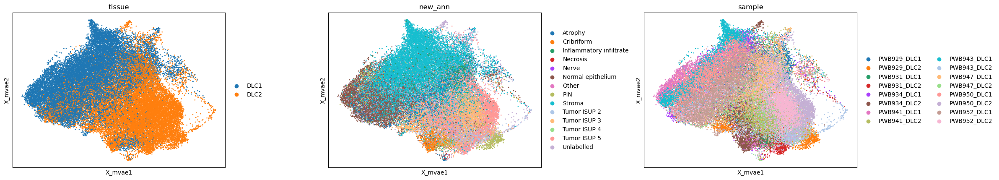

In [11]:
plot_embedding(model, mdata, train_params=train_params, poe_only=False)

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


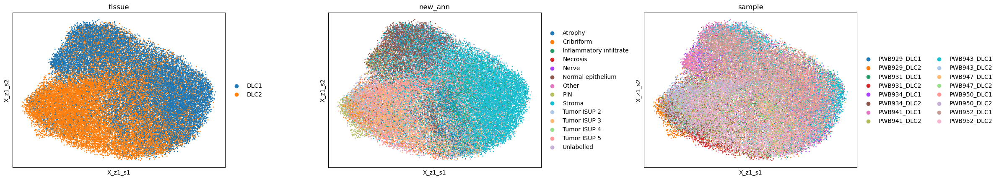

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


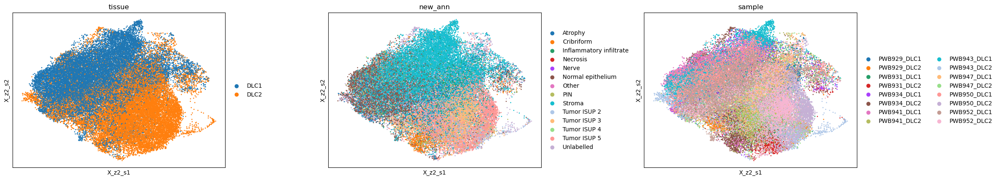

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


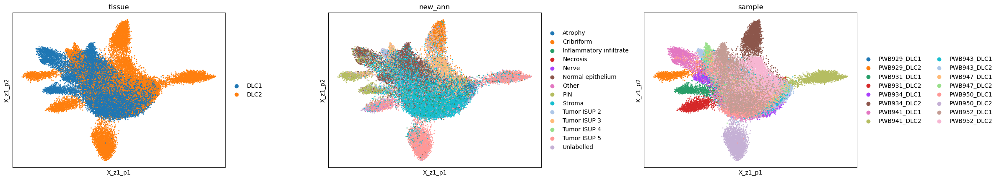

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


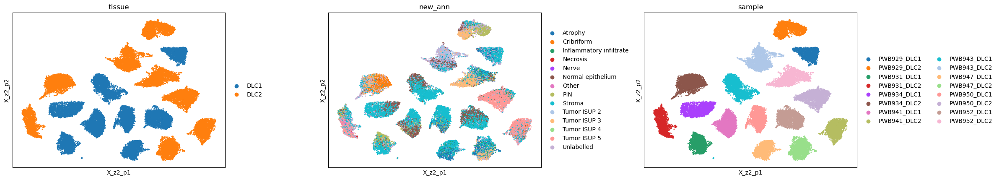

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


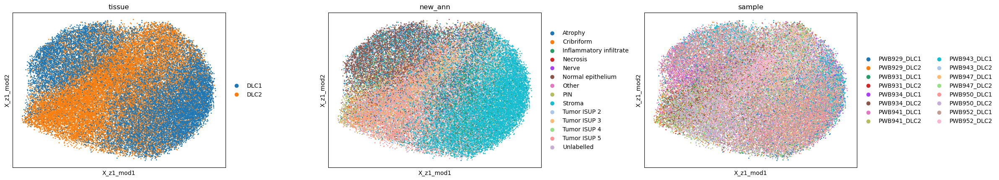

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


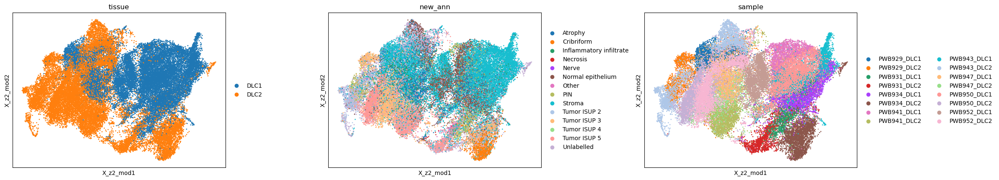

In [12]:
for layer in ["X_z1_s", "X_z2_s", "X_z1_p", "X_z2_p", "X_z1_mod", "X_z2_mod"]:
    sc.pl.embedding(
            mdata,
            layer,
            color=["tissue", "new_ann", "sample"],
            size=15,
            wspace=0.35,
        )

### beta=0.01, gamma=0.0001, delta=1.0

In [13]:
train_params = TrainParams(inverse_lisi_on_private=True, train_size=0.8, n_epochs=100, learning_rate=1e-4, batch_size=128, params_file="mvae_beta0.001_gamma0.0001_delta1.0")
model_params = ModelParams(beta=0.01, gamma=0.0001, delta=1.0, n_layers=2, z_dim=100, n_hidden=300, use_cuda=True)
torch.set_num_threads(16)
model = MVAE(mdata, model_params)

In [14]:
# train_mvae(model, mdata, train_params,"sample")
model.load_state_dict(torch.load("vae_params/mvae_beta0.001_gamma0.0001_delta1.0_20230506-211801.pt"))

<All keys matched successfully>

In [ ]:
plot_embedding(model, mdata, train_params=train_params, poe_only=False)

In [ ]:
for layer in ["X_z1_s", "X_z2_s", "X_z1_p", "X_z2_p", "X_z1_mod", "X_z2_mod"]:
    sc.pl.embedding(
            mdata,
            layer,
            color=["tissue", "new_ann", "sample"],
            size=15,
            wspace=0.35,
        )

In [23]:
train_params = TrainParams(inverse_lisi_on_private=True, train_size=0.8, n_epochs=100, learning_rate=1e-4, batch_size=128, params_file="mvae_beta0.001_gamma0.0003_delta0.1")
model_params = ModelParams(beta=0.001, gamma=0.0003, delta=0.1, n_layers=2, z_dim=100, n_hidden=300, use_cuda=True)
torch.set_num_threads(16)
model = MVAE(mdata, model_params)

In [24]:
# train_mvae(model, mdata, train_params,"sample")
model.load_state_dict(torch.load("vae_params/mvae_beta0.001_gamma0.0003_delta0.1_20230507-150411.pt"))

<All keys matched successfully>

In [ ]:
plot_embedding(model, mdata, train_params=train_params, poe_only=False)

In [ ]:
for layer in ["X_z1_s", "X_z2_s", "X_z1_p", "X_z2_p", "X_z1_mod", "X_z2_mod"]:
    sc.pl.embedding(
            mdata,
            layer,
            color=["tissue", "new_ann", "sample"],
            size=15,
            wspace=0.35,
        )